In [1]:
import os

# check if in kaggle
if 'KAGGLE_CONTAINER_NAME' in os.environ:
    kaggle = True
    os.system('git clone https://github.com/lorenzo-saccaro/NNDL-recoloring-GAN')
    os.chdir('/kaggle/working/NNDL-recoloring-GAN')
    print(os.getcwd())
    # pull repo to update .py files
    os.system('git pull')
    # install needed packages
    os.system('pip install torchview')
    os.system('pip install torchinfo')
    os.system('pip install scikit-image')
    os.system('pip install scipy torchmetrics torch-fidelity lpips')

else:
    kaggle = False

In [2]:
from dataset import CocoDataset
from models import Generator
from torchvision.transforms import Compose, Resize
from torch.utils.data import DataLoader
import random
import numpy as np
import torch
import torchmetrics
from torchmetrics.image import UniversalImageQualityIndex, PeakSignalNoiseRatio, StructuralSimilarityIndexMeasure, FrechetInceptionDistance, LearnedPerceptualImagePatchSimilarity
import matplotlib.pyplot as plt
from skimage.color import lab2rgb, rgb2lab

In [3]:
## RUN PARAMETERS ##

if kaggle:
    DATASET_ROOT = '/kaggle/input/coco-2017-dataset/coco2017'
else:
    DATASET_ROOT = 'C:\\Users\\loren\\Datasets\\coco2017'

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

metrics = [FrechetInceptionDistance(normalize=True, compute_on_cpu=True).to(device),
           # inputs in [0, 1] range
           StructuralSimilarityIndexMeasure(data_range=1.0, compute_on_cpu=True).to(device),
           PeakSignalNoiseRatio(data_range=1.0, compute_on_cpu=True).to(device),
           LearnedPerceptualImagePatchSimilarity(net_type='vgg', normalize=True,
                                                 compute_on_cpu=True).to(device),
           # inputs in [0, 1] range
           UniversalImageQualityIndex(data_range=1.0, compute_on_cpu=True).to(device)]

BATCH_SIZE = 16  # TODO: to be tuned (in paper, 1 to 10 range)
NUM_WORKERS = 1

IMG_SIZE = 256
REMOVE_GRAY = True if kaggle else False  # in kaggle needs to be done every time, in local only once
USE_LAB_COLORSPACE = True  # whether to use LAB color space

DISCRIMINATOR_TYPE = 'patch_gan'  # either DCGAN or patch_gan
USE_INSTANCE_NORM = True if BATCH_SIZE == 1 else False  # norm layer type in models
GEN_IN_CHANNEL = 1  # always 1 channel for grayscale imgs
GEN_OUT_CHANNEL = 2 if USE_LAB_COLORSPACE else 3  # reconstruct only ab channels for Lab images,
DISC_IN_CHANNEL = GEN_IN_CHANNEL + GEN_OUT_CHANNEL  # discriminator take both input and output images



C:\Users\loren\anaconda3\envs\NNDL-torch\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
C:\Users\loren\anaconda3\envs\NNDL-torch\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
C:\Users\loren\anaconda3\envs\NNDL-torch\lib\site-packages\torchmetrics\utilities\prints.py:36: UserWarning: Metric `UniversalImageQualityIndex` will save all targets and predictions in buffer. For large datasets this may lead to large memory footprint.
  warnings.warn(*args, **kwargs)


In [4]:
## SET SEEDS ##

SEED = 123456
random.seed(SEED)
np.random.seed(SEED)
torch.manual_seed(SEED)
torch.backends.cudnn.benchmark = False
torch.use_deterministic_algorithms(True)
os.environ["CUBLAS_WORKSPACE_CONFIG"] = ':4096:8'

# Load datasets

In [5]:
# No need to include ToTensor, already applied in dataset

transforms_train = Compose([Resize((IMG_SIZE, IMG_SIZE))])
transforms_val = Compose([Resize((IMG_SIZE, IMG_SIZE))])
transforms_test = Compose([Resize((IMG_SIZE, IMG_SIZE))])

In [6]:
train_dataset = CocoDataset(dataset_folder=DATASET_ROOT, dataset_type='train', transforms=transforms_train,
                            frac=0.2, use_lab_colorspace=USE_LAB_COLORSPACE, remove_gray=REMOVE_GRAY)

val_dataset = CocoDataset(dataset_folder=DATASET_ROOT, dataset_type='val', transforms=transforms_val,
                          frac=1, use_lab_colorspace=USE_LAB_COLORSPACE)

test_dataset = CocoDataset(dataset_folder=DATASET_ROOT, dataset_type='test', transforms=transforms_test,
                           frac=1, use_lab_colorspace=USE_LAB_COLORSPACE)

In [7]:
train_dataloader = DataLoader(dataset=train_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=NUM_WORKERS,
                              pin_memory=False, persistent_workers=True, drop_last=(1 <= len(train_dataset)%BATCH_SIZE <= 8))

val_dataloader = DataLoader(dataset=val_dataset, batch_size=BATCH_SIZE, shuffle=False, num_workers=NUM_WORKERS,
                            pin_memory=False, persistent_workers=True, drop_last=(1 <= len(val_dataset)%BATCH_SIZE <= 8))

test_dataloader = DataLoader(dataset=test_dataset, batch_size=BATCH_SIZE, shuffle=False, num_workers=NUM_WORKERS,
                             pin_memory=False, persistent_workers=True)

In [8]:
checkpoint_pgan = torch.load('gan_pixel.tar')
history_pgan = checkpoint_pgan['history']

checkpoint_gan = torch.load('gan.tar')
history_gan = checkpoint_gan['history']

checkpoint_wgan = torch.load('wgan.tar')
history_wgan = checkpoint_wgan['history']


# Plol metrics

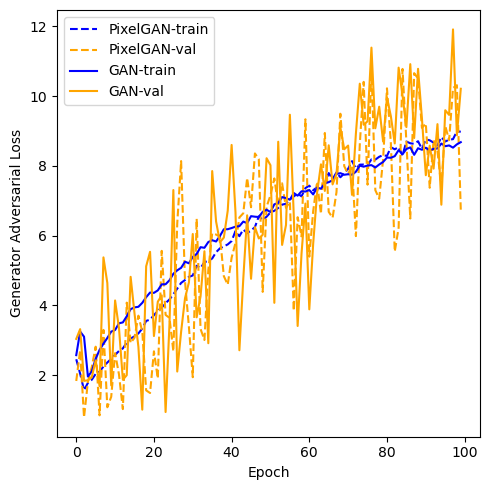

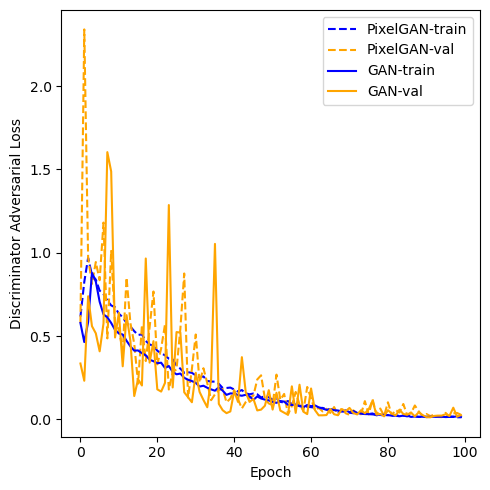

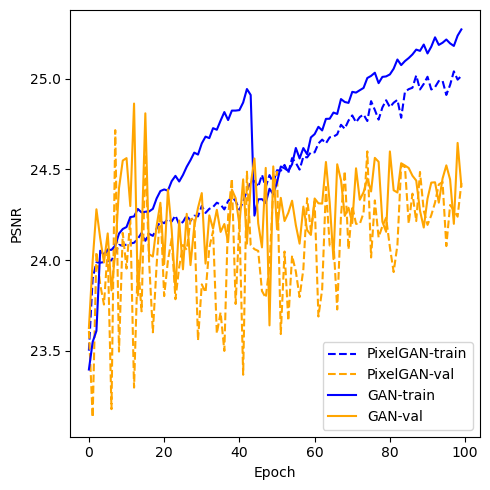

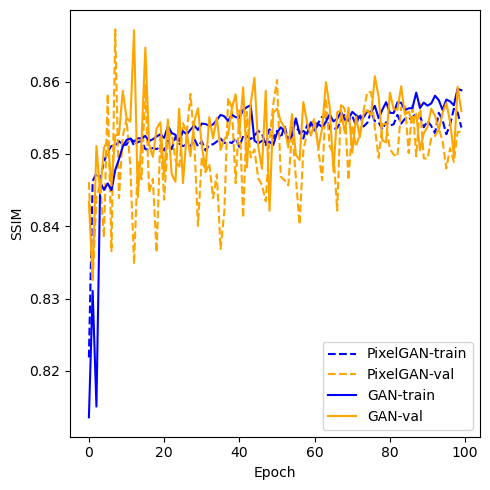

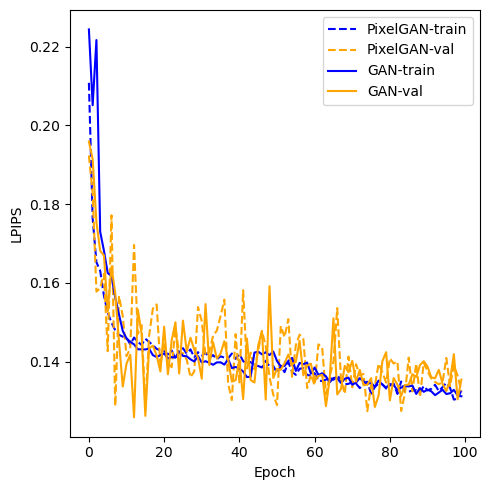

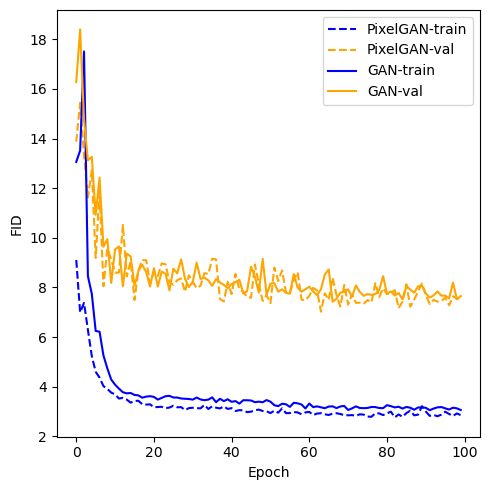

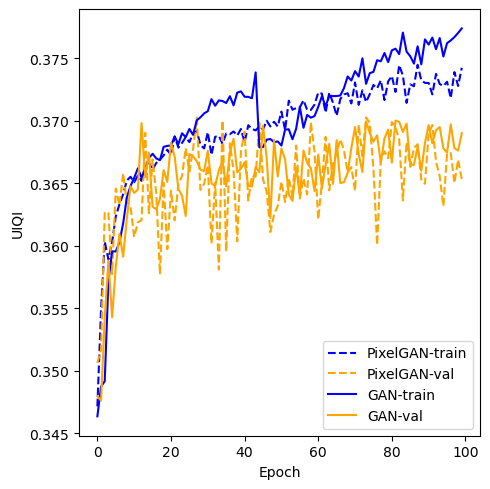

In [9]:
# plot generator loss
fig, ax = plt.subplots(1, 1, figsize=(5, 5))
ax.plot(history_pgan['train_gen_loss_gan'], label='PixelGAN-train', color='blue', linestyle='--')
ax.plot(history_pgan['val_gen_loss_gan'], label='PixelGAN-val', color='orange', linestyle='--')
ax.plot(history_gan['train_gen_loss_gan'], label='GAN-train', color='blue', linestyle='-')
ax.plot(history_gan['val_gen_loss_gan'], label='GAN-val', color='orange', linestyle='-')
ax.set_xlabel('Epoch')
ax.set_ylabel('Generator Adversarial Loss')

plt.legend()
plt.tight_layout()
plt.savefig('./plots/gen_loss.png')
plt.show()

# plot discriminator loss
fig, ax = plt.subplots(1, 1, figsize=(5, 5))
ax.plot(history_pgan['train_disc_loss'], label='PixelGAN-train', color='blue', linestyle='--')
ax.plot(history_pgan['val_disc_loss'], label='PixelGAN-val', color='orange', linestyle='--')
ax.plot(history_gan['train_disc_loss'], label='GAN-train', color='blue', linestyle='-')
ax.plot(history_gan['val_disc_loss'], label='GAN-val', color='orange', linestyle='-')
ax.set_xlabel('Epoch')
ax.set_ylabel('Discriminator Adversarial Loss')

plt.legend()
plt.tight_layout()
plt.savefig('./plots/disc_loss.png')
plt.show()

# plot PSNR
fig, ax = plt.subplots(1, 1, figsize=(5, 5))
ax.plot(history_pgan['train_peaksignalnoiseratio'], label='PixelGAN-train', color='blue', linestyle='--')
ax.plot(history_pgan['val_peaksignalnoiseratio'], label='PixelGAN-val', color='orange', linestyle='--')
ax.plot(history_gan['train_peaksignalnoiseratio'], label='GAN-train', color='blue', linestyle='-')
ax.plot(history_gan['val_peaksignalnoiseratio'], label='GAN-val', color='orange', linestyle='-')
ax.set_xlabel('Epoch')
ax.set_ylabel('PSNR')

plt.legend()
plt.tight_layout()
plt.savefig('./plots/psnr.png')
plt.show()

# plot SSIM
fig, ax = plt.subplots(1, 1, figsize=(5, 5))
ax.plot(history_pgan['train_structuralsimilarityindexmeasure'], label='PixelGAN-train', color='blue', linestyle='--')
ax.plot(history_pgan['val_structuralsimilarityindexmeasure'], label='PixelGAN-val', color='orange', linestyle='--')
ax.plot(history_gan['train_structuralsimilarityindexmeasure'], label='GAN-train', color='blue', linestyle='-')
ax.plot(history_gan['val_structuralsimilarityindexmeasure'], label='GAN-val', color='orange', linestyle='-')
ax.set_xlabel('Epoch')
ax.set_ylabel('SSIM')

plt.legend()
plt.tight_layout()
plt.savefig('./plots/ssim.png')
plt.show()

# plot LPIPS
fig, ax = plt.subplots(1, 1, figsize=(5, 5))
ax.plot(history_pgan['train_learnedperceptualimagepatchsimilarity'], label='PixelGAN-train', color='blue', linestyle='--')
ax.plot(history_pgan['val_learnedperceptualimagepatchsimilarity'], label='PixelGAN-val', color='orange', linestyle='--')
ax.plot(history_gan['train_learnedperceptualimagepatchsimilarity'], label='GAN-train', color='blue', linestyle='-')
ax.plot(history_gan['val_learnedperceptualimagepatchsimilarity'], label='GAN-val', color='orange', linestyle='-')
ax.set_xlabel('Epoch')
ax.set_ylabel('LPIPS')

plt.legend()
plt.tight_layout()
plt.savefig('./plots/lpips.png')
plt.show()

# plot FID
fig, ax = plt.subplots(1, 1, figsize=(5, 5))
ax.plot(history_pgan['train_frechetinceptiondistance'], label='PixelGAN-train', color='blue', linestyle='--')
ax.plot(history_pgan['val_frechetinceptiondistance'], label='PixelGAN-val', color='orange', linestyle='--')
ax.plot(history_gan['train_frechetinceptiondistance'], label='GAN-train', color='blue', linestyle='-')
ax.plot(history_gan['val_frechetinceptiondistance'], label='GAN-val', color='orange', linestyle='-')
ax.set_xlabel('Epoch')
ax.set_ylabel('FID')

plt.legend()
plt.tight_layout()
plt.savefig('./plots/fid.png')
plt.show()

# plot uiqi
fig, ax = plt.subplots(1, 1, figsize=(5, 5))
ax.plot(history_pgan['train_universalimagequalityindex'], label='PixelGAN-train', color='blue', linestyle='--')
ax.plot(history_pgan['val_universalimagequalityindex'], label='PixelGAN-val', color='orange', linestyle='--')
ax.plot(history_gan['train_universalimagequalityindex'], label='GAN-train', color='blue', linestyle='-')
ax.plot(history_gan['val_universalimagequalityindex'], label='GAN-val', color='orange', linestyle='-')
ax.set_xlabel('Epoch')
ax.set_ylabel('UIQI')

plt.legend()
plt.tight_layout()
plt.savefig('./plots/uiqi.png')
plt.show()



# Load the model

In [10]:
generator_gan = Generator(use_instance_norm=USE_INSTANCE_NORM, in_channels=GEN_IN_CHANNEL, out_channels=GEN_OUT_CHANNEL)
generator_gan.to(device)
generator_gan.load_state_dict(checkpoint_gan['generator'])

generator_pgan = Generator(use_instance_norm=USE_INSTANCE_NORM, in_channels=GEN_IN_CHANNEL, out_channels=GEN_OUT_CHANNEL, use_pixelTCL=True)
generator_pgan.to(device)
generator_pgan.load_state_dict(checkpoint_pgan['generator'])

generator_wgan = Generator(use_instance_norm=USE_INSTANCE_NORM, in_channels=GEN_IN_CHANNEL, out_channels=GEN_OUT_CHANNEL)
generator_wgan.to(device)
generator_wgan.load_state_dict(checkpoint_wgan['generator'])

<All keys matched successfully>

# Plot some samples

C:\Users\loren\anaconda3\envs\NNDL-torch\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 48 pixels
  return func(*args, **kwargs)


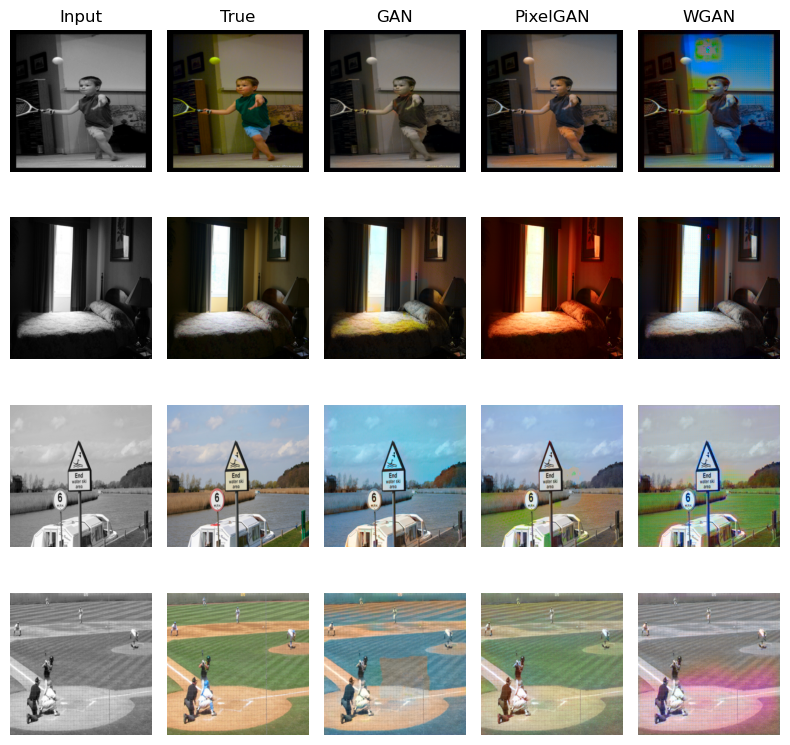

C:\Users\loren\anaconda3\envs\NNDL-torch\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 5 pixels
  return func(*args, **kwargs)
C:\Users\loren\anaconda3\envs\NNDL-torch\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 104 pixels
  return func(*args, **kwargs)


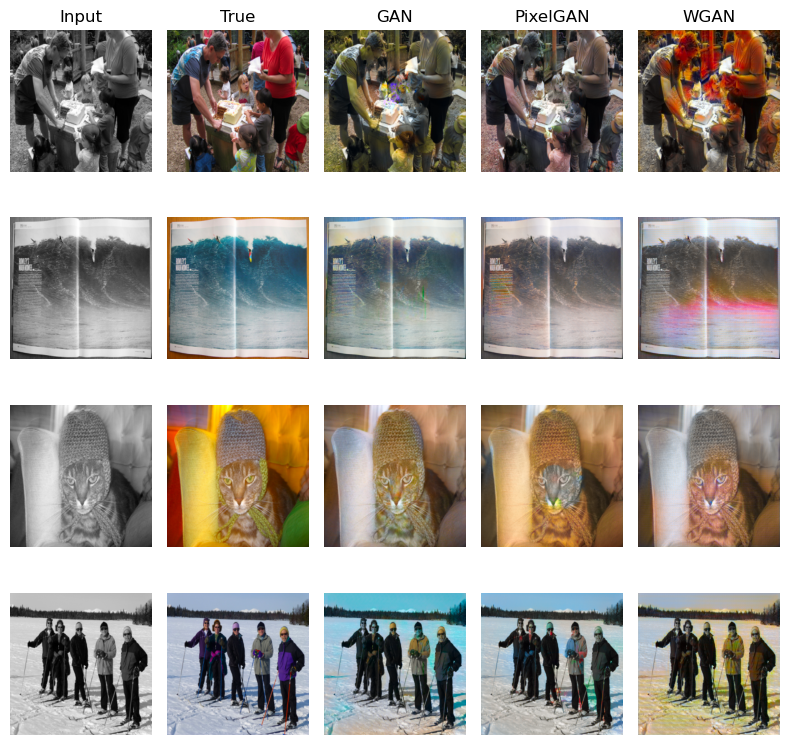

C:\Users\loren\anaconda3\envs\NNDL-torch\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 11 pixels
  return func(*args, **kwargs)
C:\Users\loren\anaconda3\envs\NNDL-torch\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 259 pixels
  return func(*args, **kwargs)


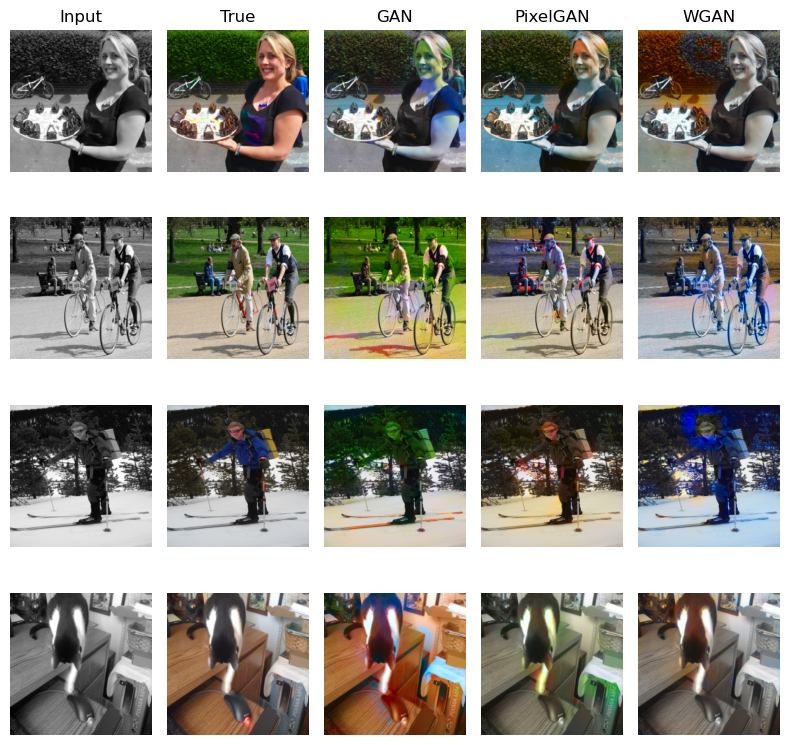

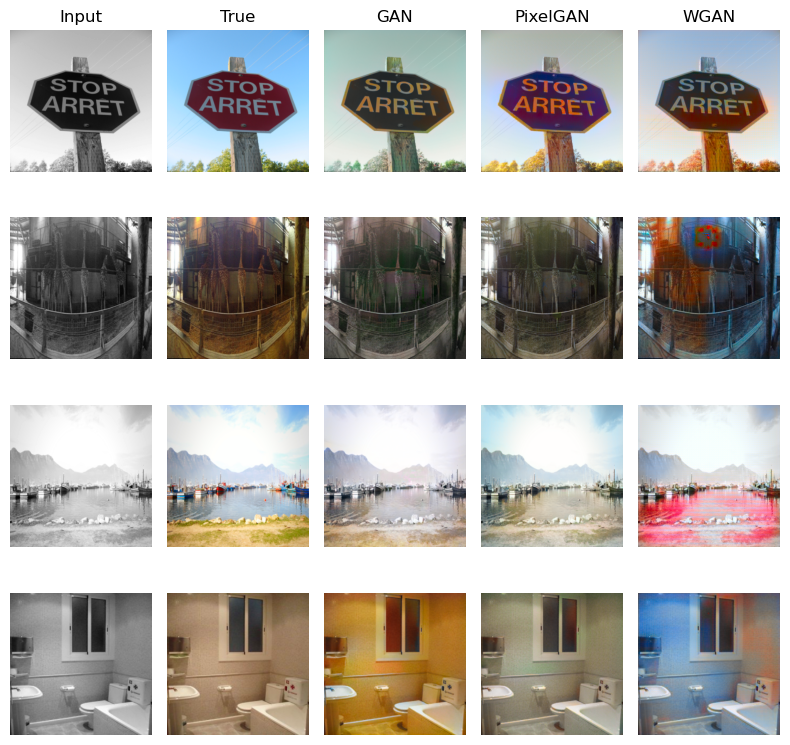

C:\Users\loren\anaconda3\envs\NNDL-torch\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 49 pixels
  return func(*args, **kwargs)


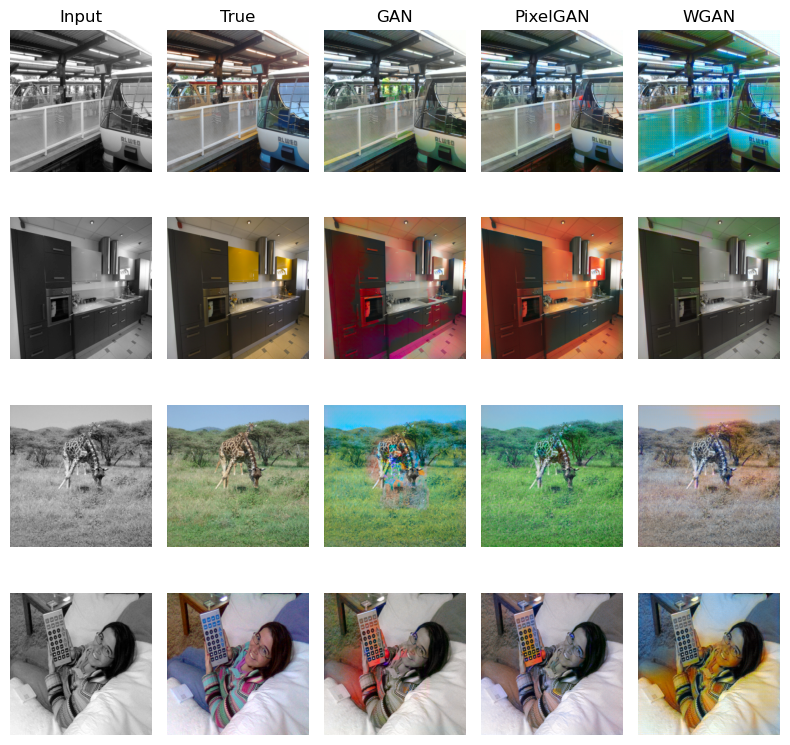

C:\Users\loren\anaconda3\envs\NNDL-torch\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 154 pixels
  return func(*args, **kwargs)


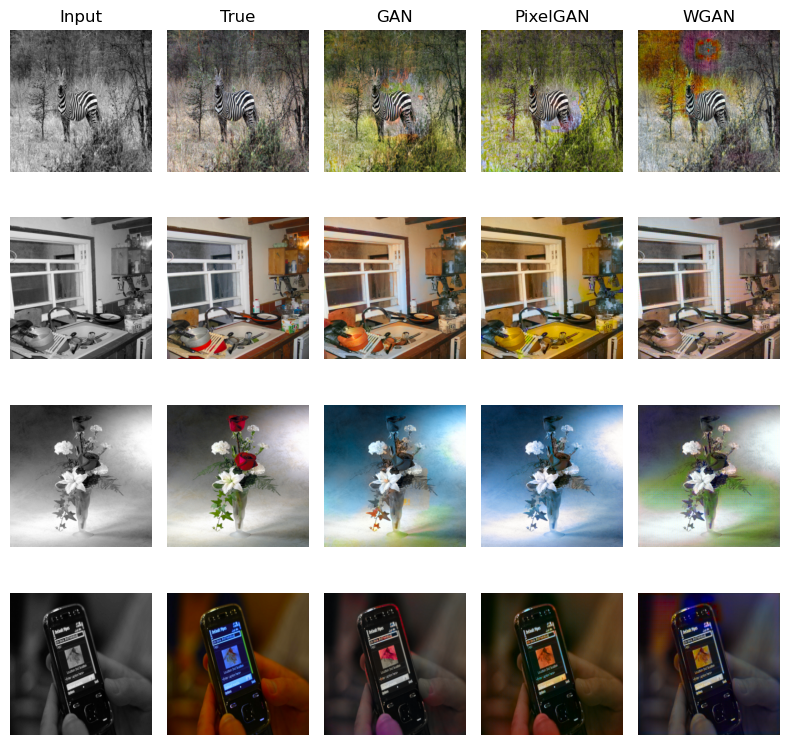

C:\Users\loren\anaconda3\envs\NNDL-torch\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 174 pixels
  return func(*args, **kwargs)


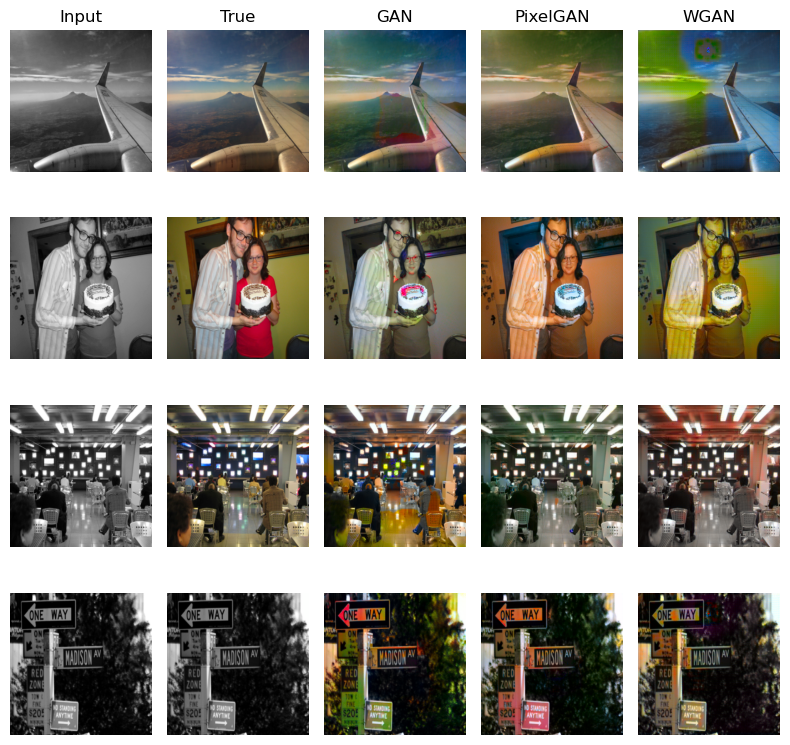

C:\Users\loren\anaconda3\envs\NNDL-torch\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 120 pixels
  return func(*args, **kwargs)


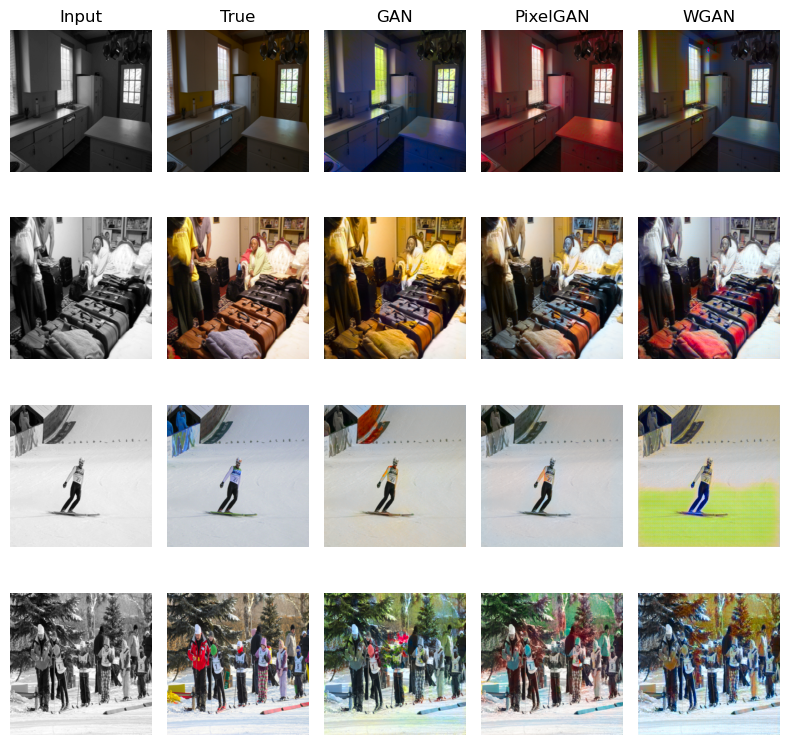

C:\Users\loren\anaconda3\envs\NNDL-torch\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 12 pixels
  return func(*args, **kwargs)
C:\Users\loren\anaconda3\envs\NNDL-torch\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 72 pixels
  return func(*args, **kwargs)


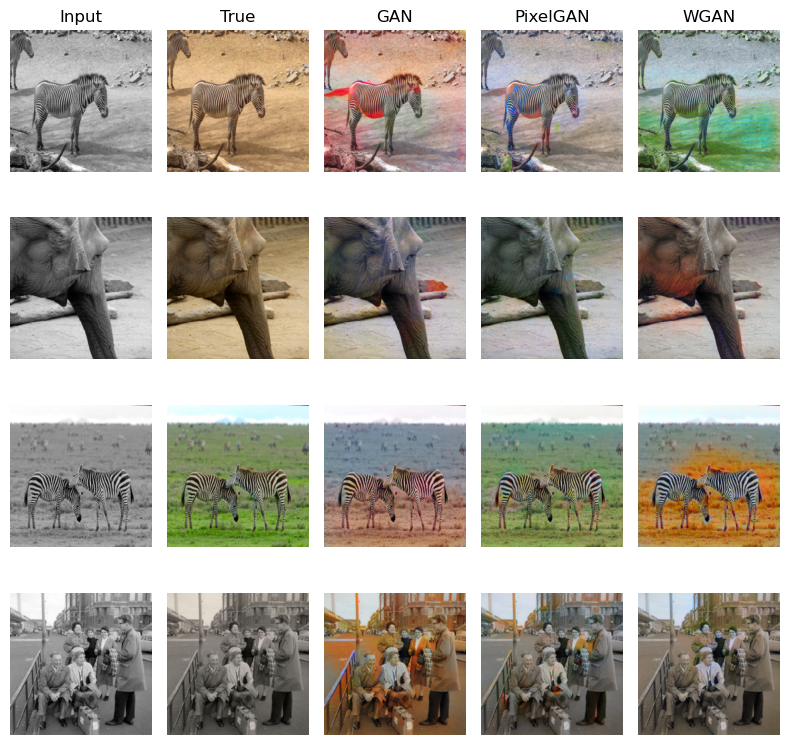

C:\Users\loren\anaconda3\envs\NNDL-torch\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 164 pixels
  return func(*args, **kwargs)


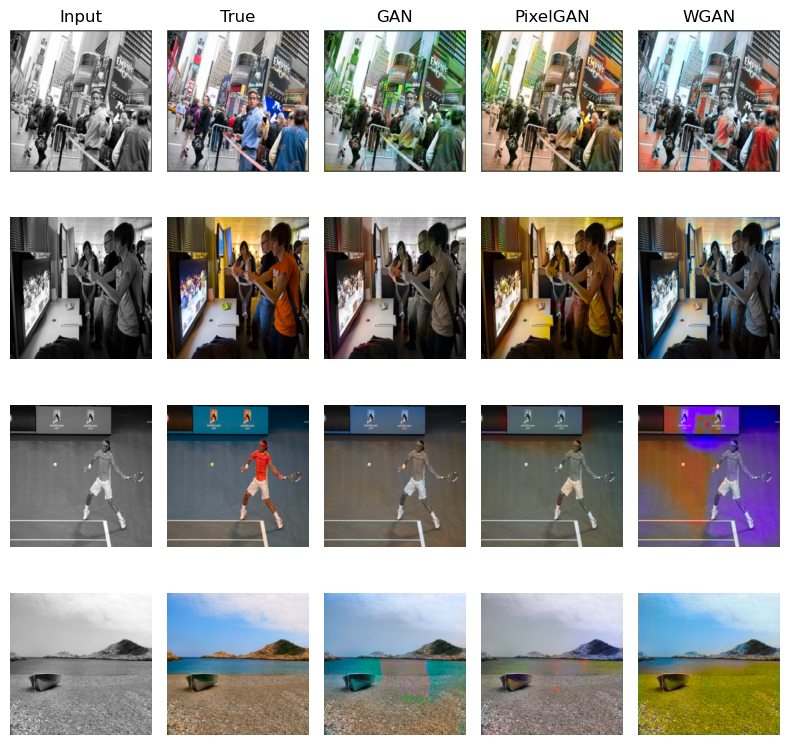

C:\Users\loren\anaconda3\envs\NNDL-torch\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 111 pixels
  return func(*args, **kwargs)
C:\Users\loren\anaconda3\envs\NNDL-torch\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 280 pixels
  return func(*args, **kwargs)


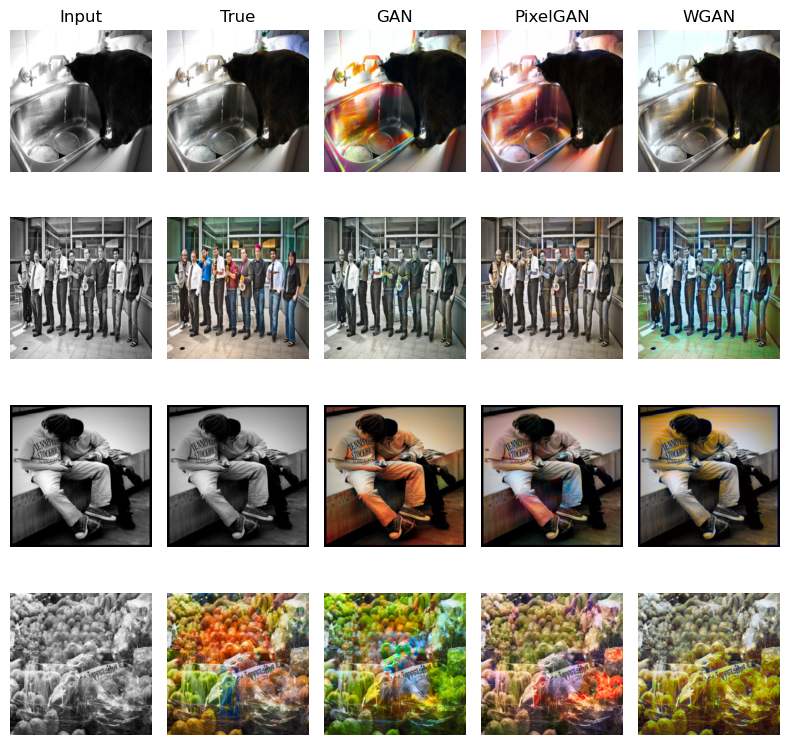

C:\Users\loren\anaconda3\envs\NNDL-torch\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 7 pixels
  return func(*args, **kwargs)
C:\Users\loren\anaconda3\envs\NNDL-torch\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 79 pixels
  return func(*args, **kwargs)


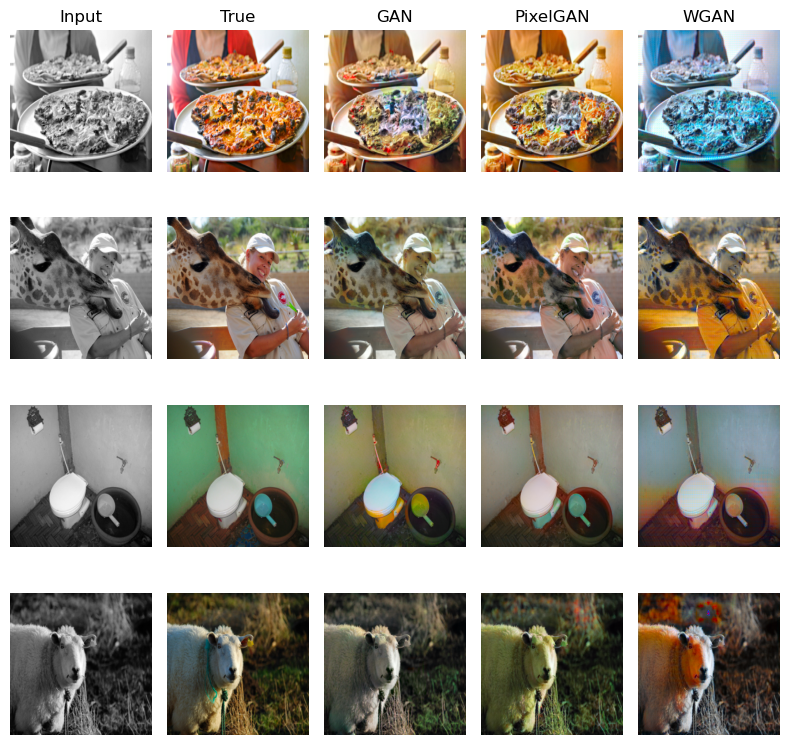

C:\Users\loren\anaconda3\envs\NNDL-torch\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 242 pixels
  return func(*args, **kwargs)


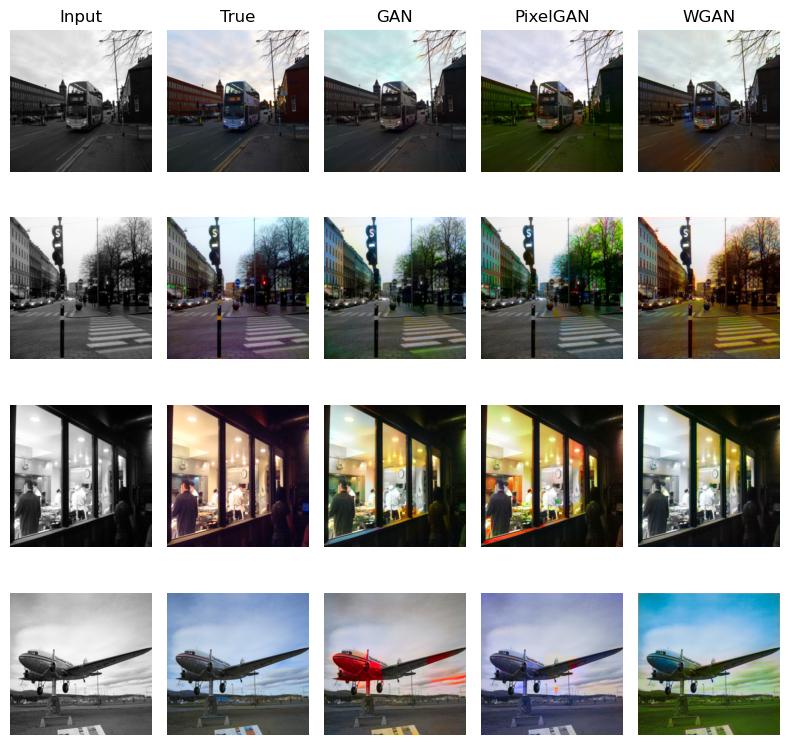

C:\Users\loren\anaconda3\envs\NNDL-torch\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 117 pixels
  return func(*args, **kwargs)


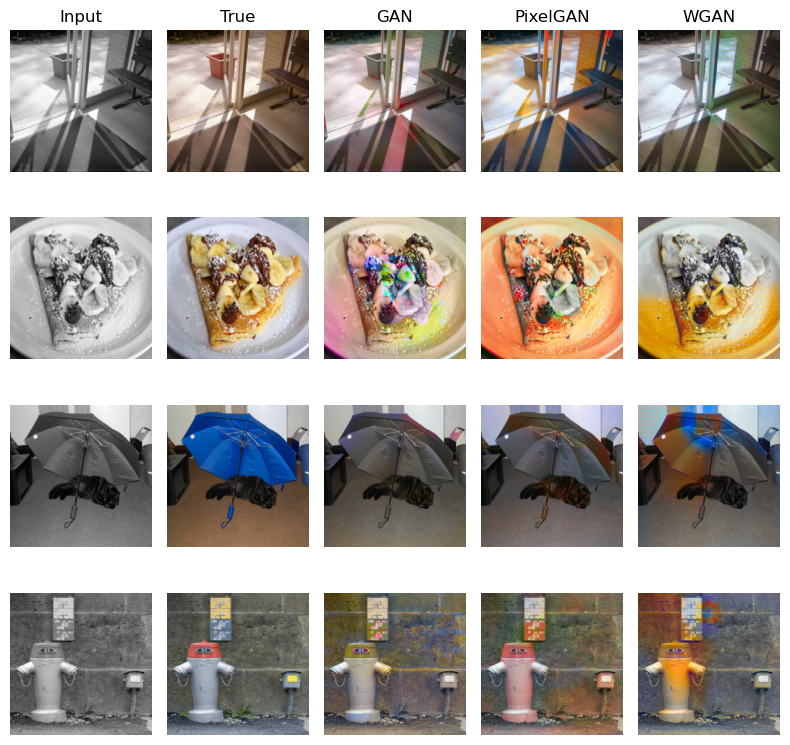

C:\Users\loren\anaconda3\envs\NNDL-torch\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 105 pixels
  return func(*args, **kwargs)


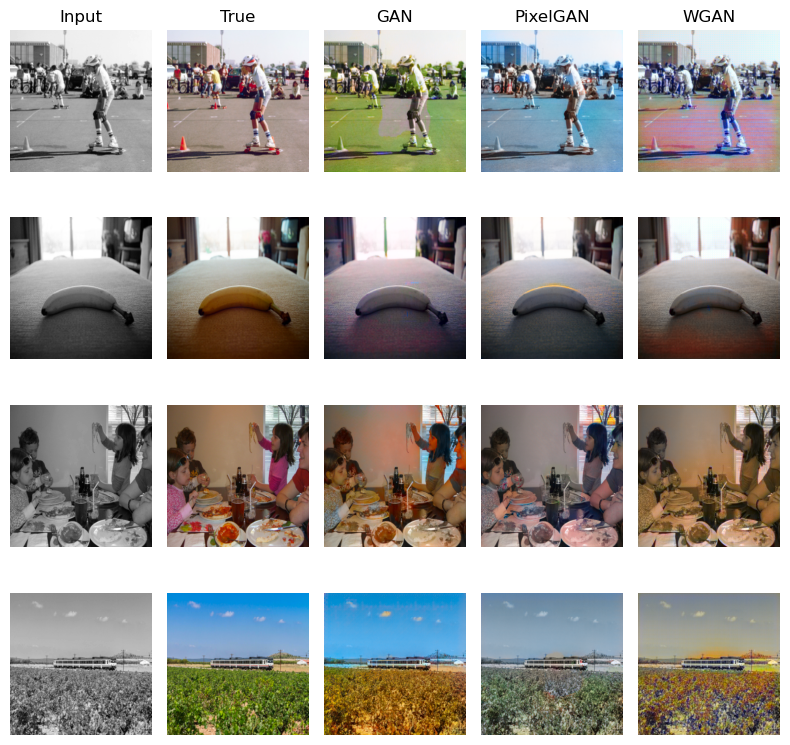

C:\Users\loren\anaconda3\envs\NNDL-torch\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 349 pixels
  return func(*args, **kwargs)


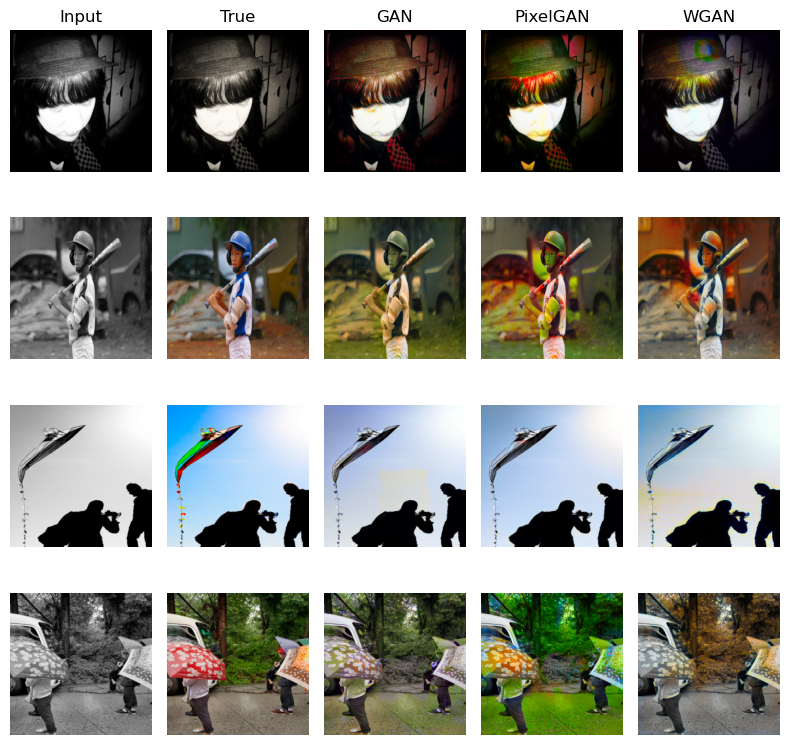

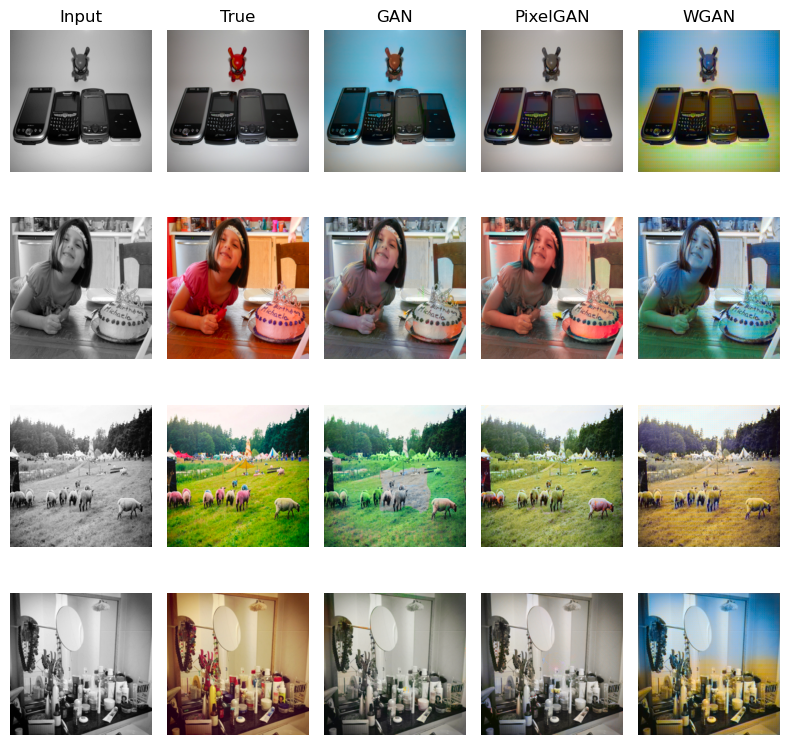

C:\Users\loren\anaconda3\envs\NNDL-torch\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 109 pixels
  return func(*args, **kwargs)


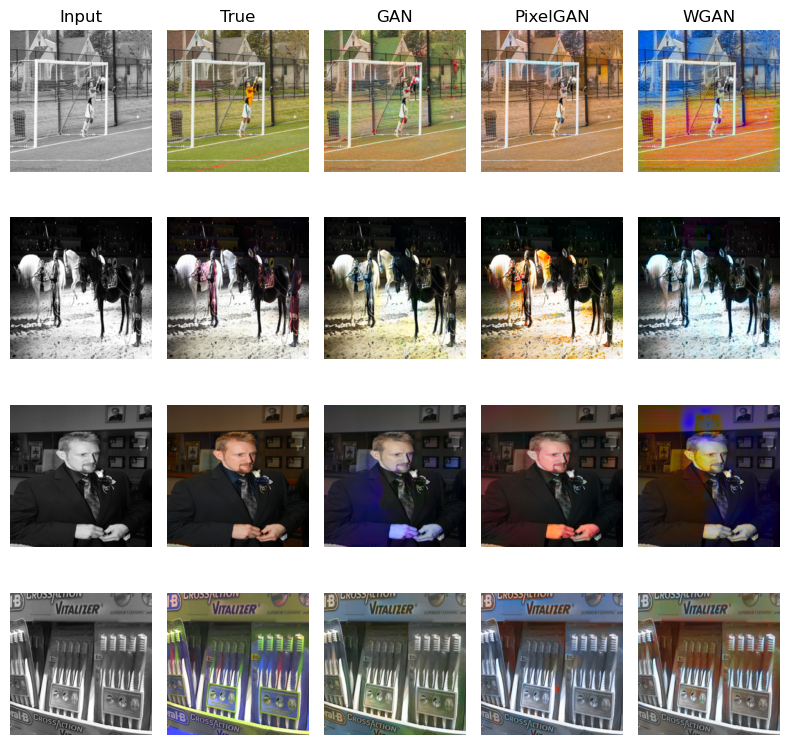

C:\Users\loren\anaconda3\envs\NNDL-torch\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 258 pixels
  return func(*args, **kwargs)


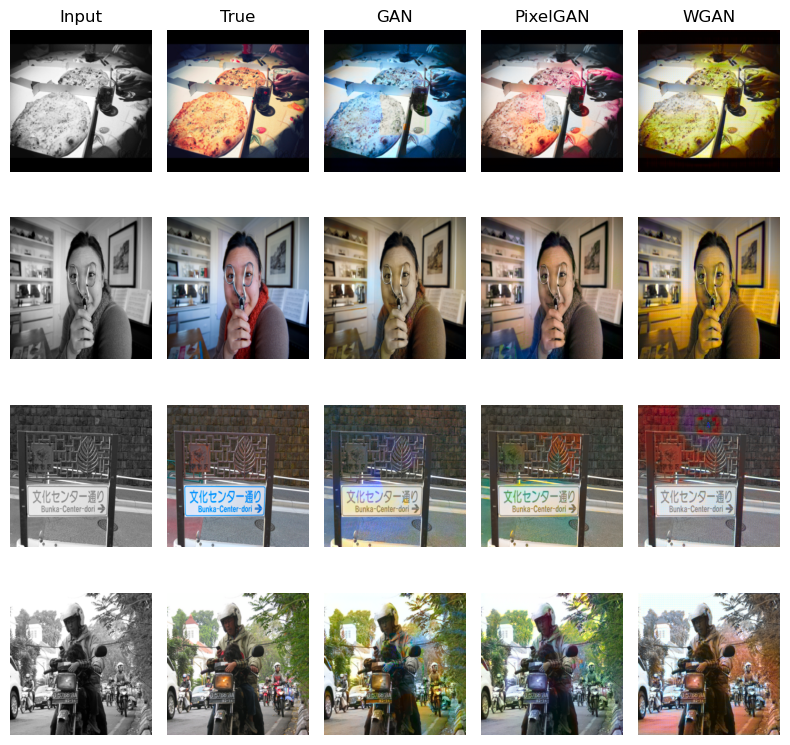

C:\Users\loren\anaconda3\envs\NNDL-torch\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 107 pixels
  return func(*args, **kwargs)


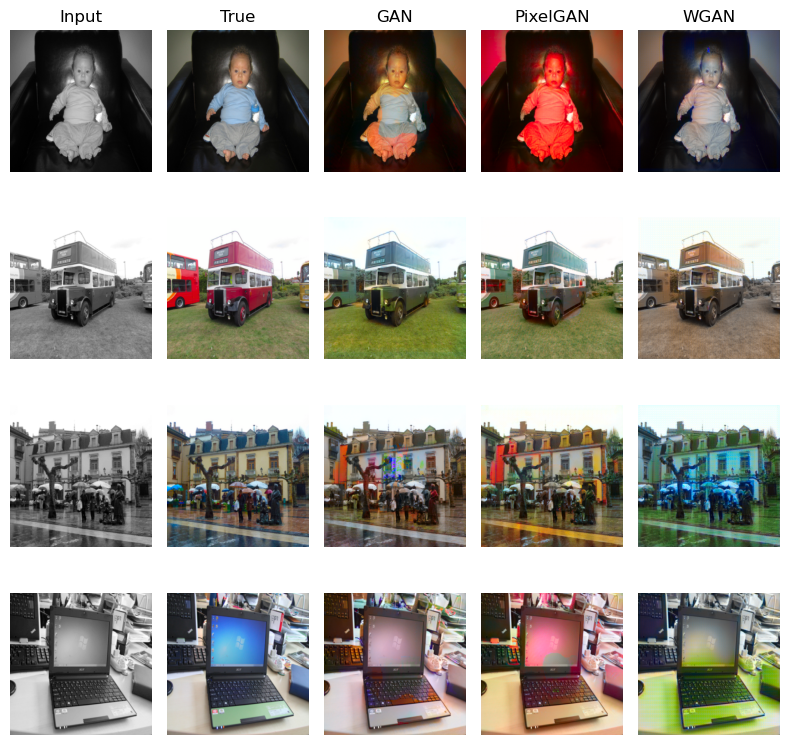

C:\Users\loren\anaconda3\envs\NNDL-torch\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 146 pixels
  return func(*args, **kwargs)


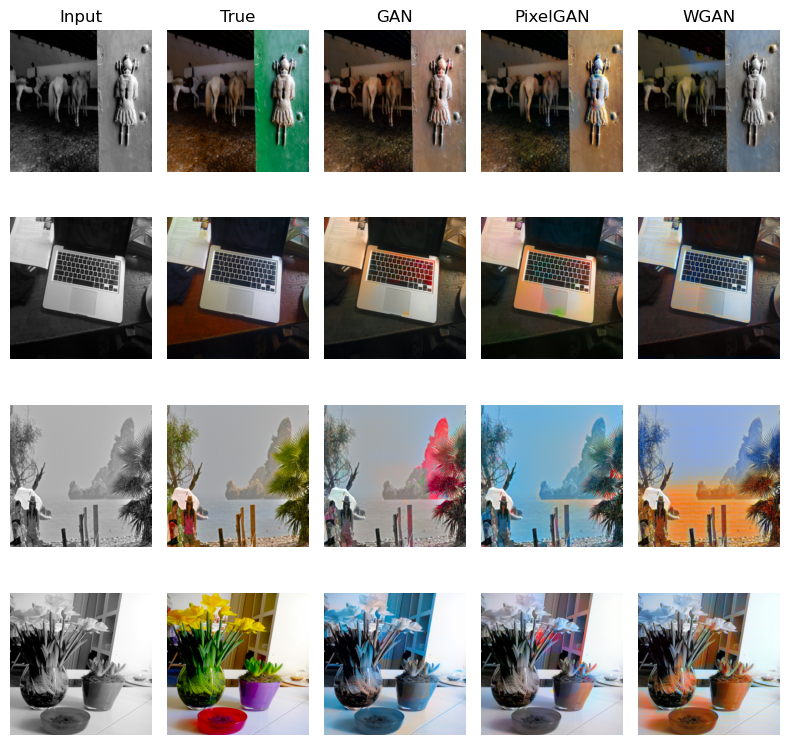

C:\Users\loren\anaconda3\envs\NNDL-torch\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 102 pixels
  return func(*args, **kwargs)


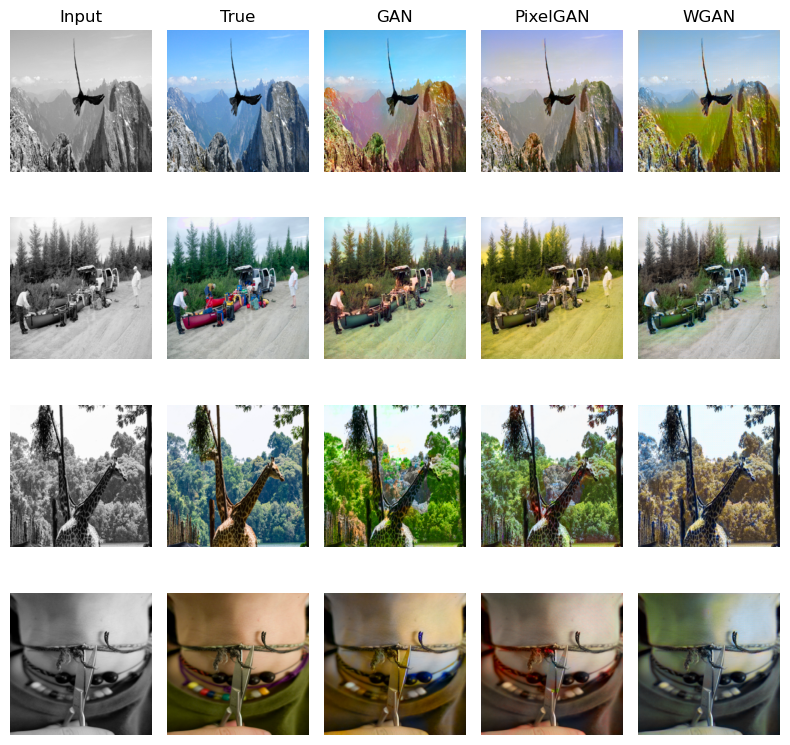

C:\Users\loren\anaconda3\envs\NNDL-torch\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 147 pixels
  return func(*args, **kwargs)


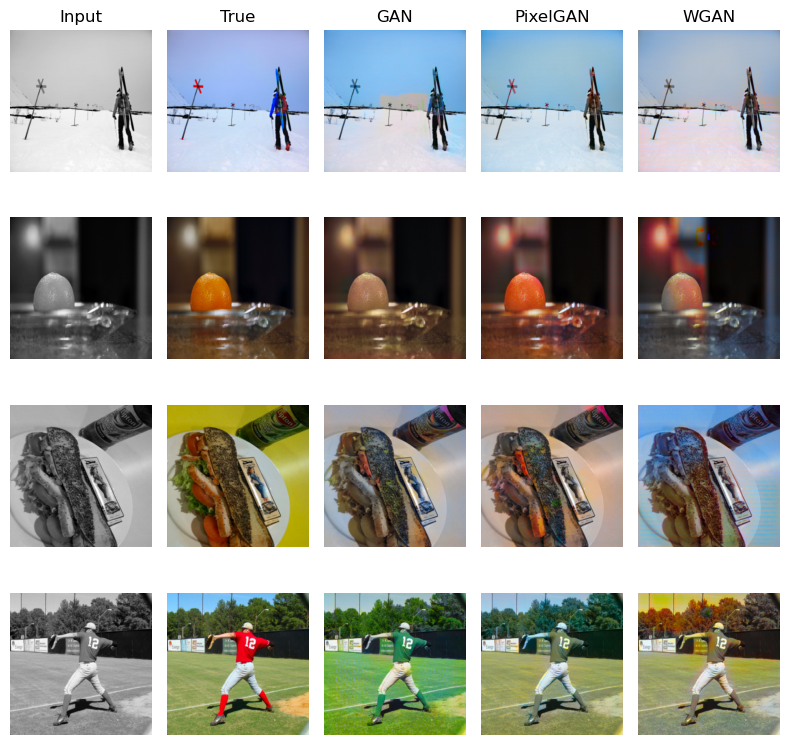

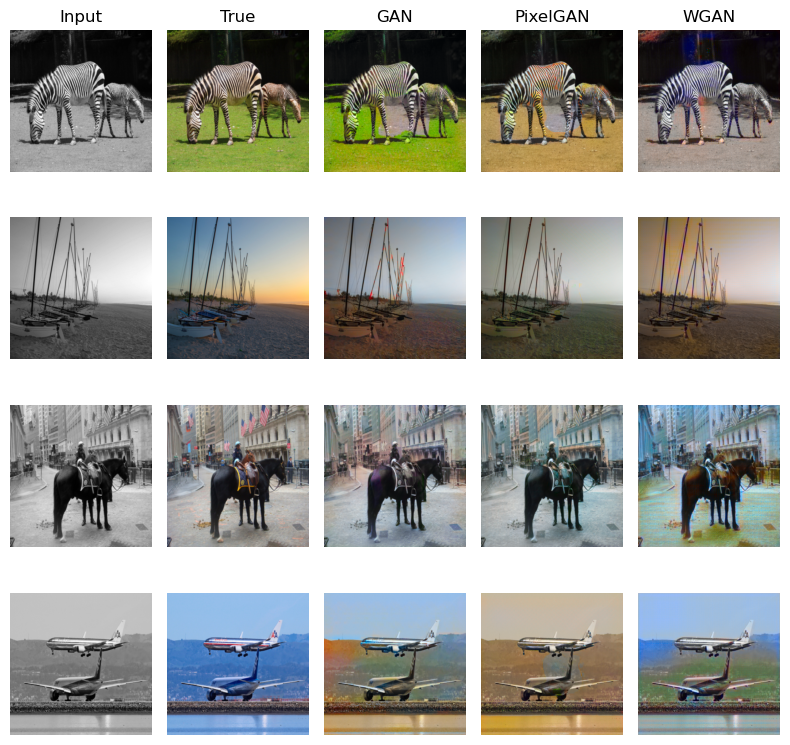

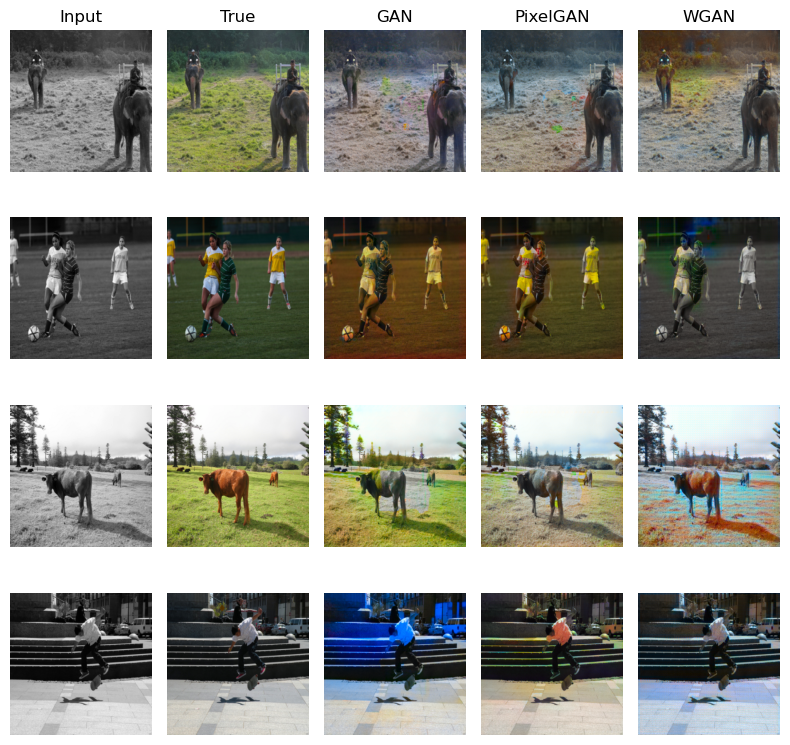

C:\Users\loren\anaconda3\envs\NNDL-torch\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 66 pixels
  return func(*args, **kwargs)


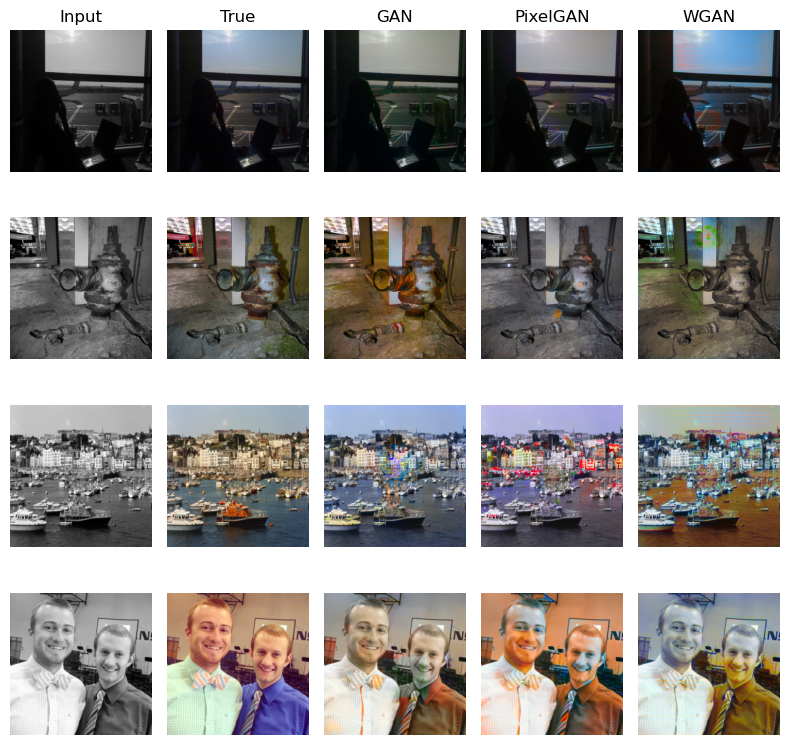

C:\Users\loren\anaconda3\envs\NNDL-torch\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 90 pixels
  return func(*args, **kwargs)


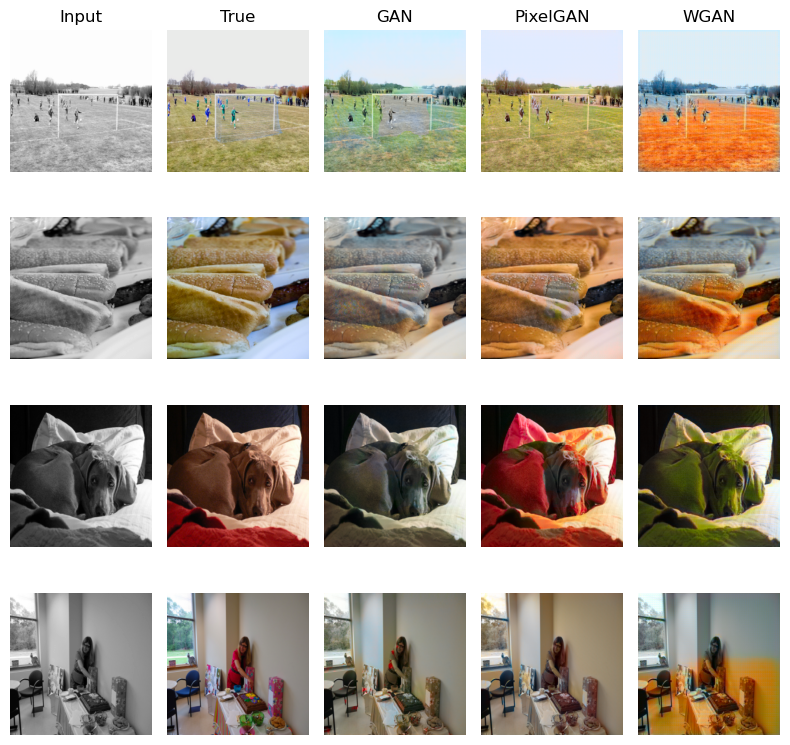

C:\Users\loren\anaconda3\envs\NNDL-torch\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 233 pixels
  return func(*args, **kwargs)


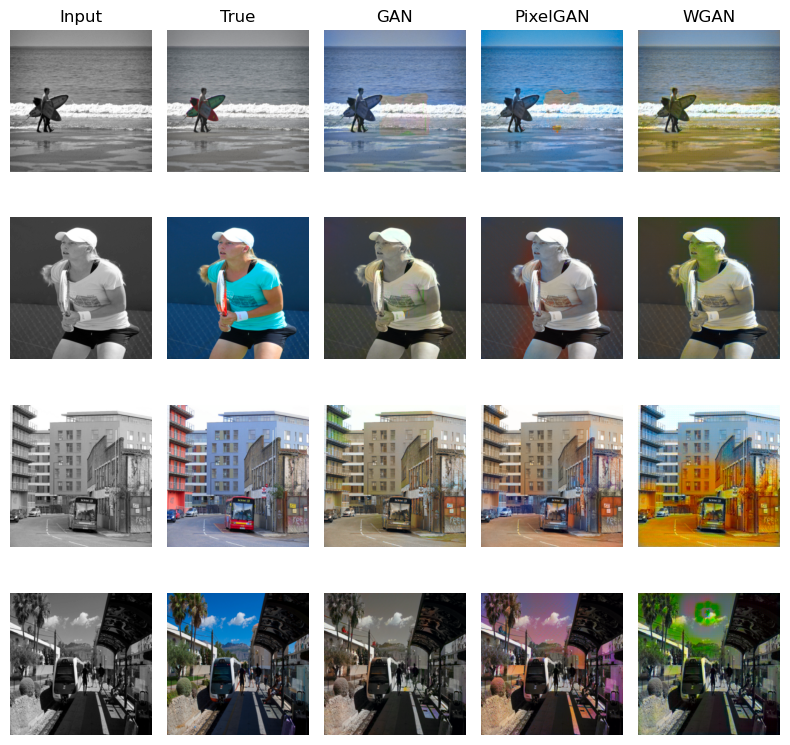

C:\Users\loren\anaconda3\envs\NNDL-torch\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 159 pixels
  return func(*args, **kwargs)


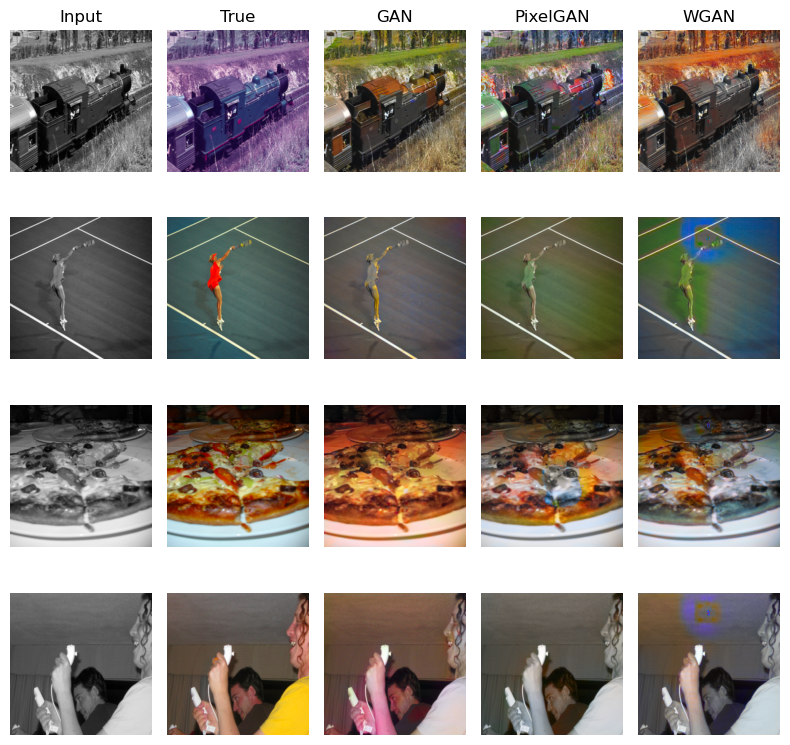

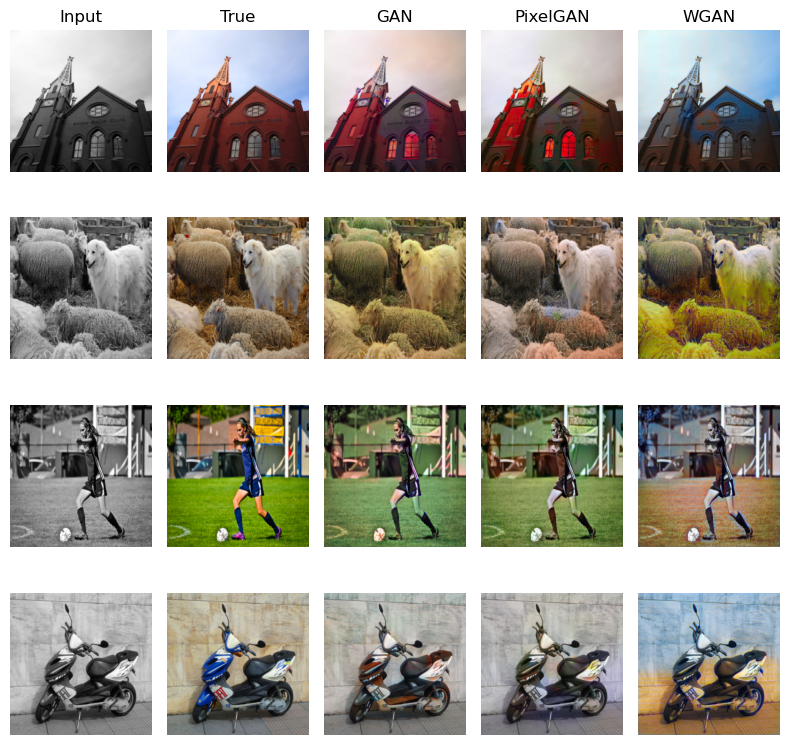

C:\Users\loren\anaconda3\envs\NNDL-torch\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 188 pixels
  return func(*args, **kwargs)


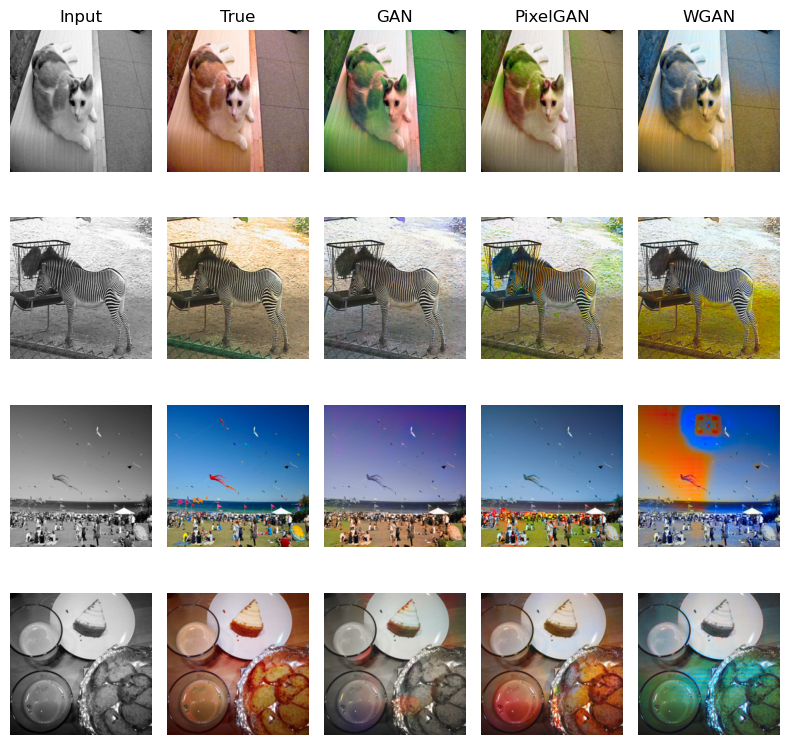

C:\Users\loren\anaconda3\envs\NNDL-torch\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 25 pixels
  return func(*args, **kwargs)


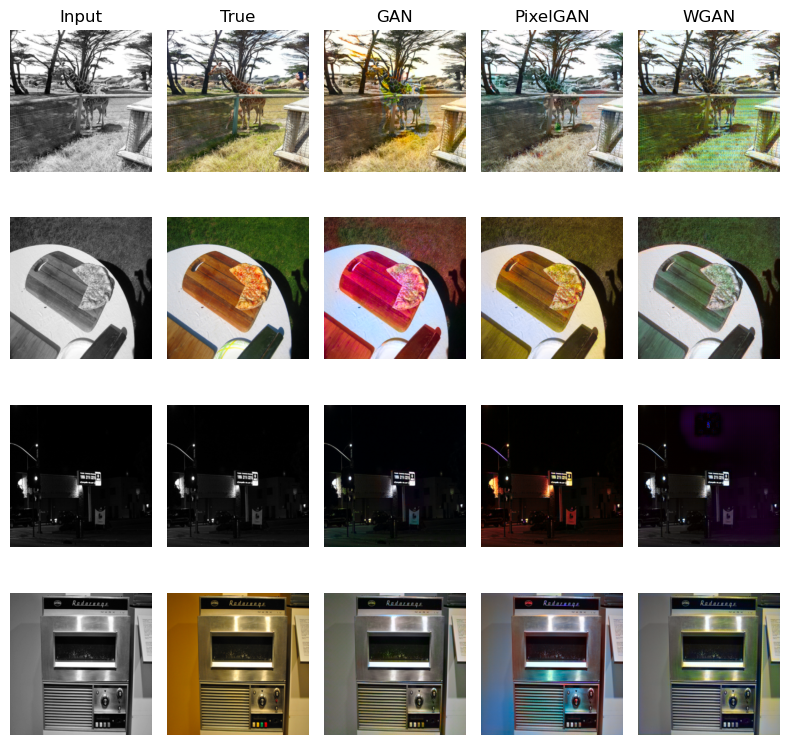

C:\Users\loren\anaconda3\envs\NNDL-torch\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 228 pixels
  return func(*args, **kwargs)


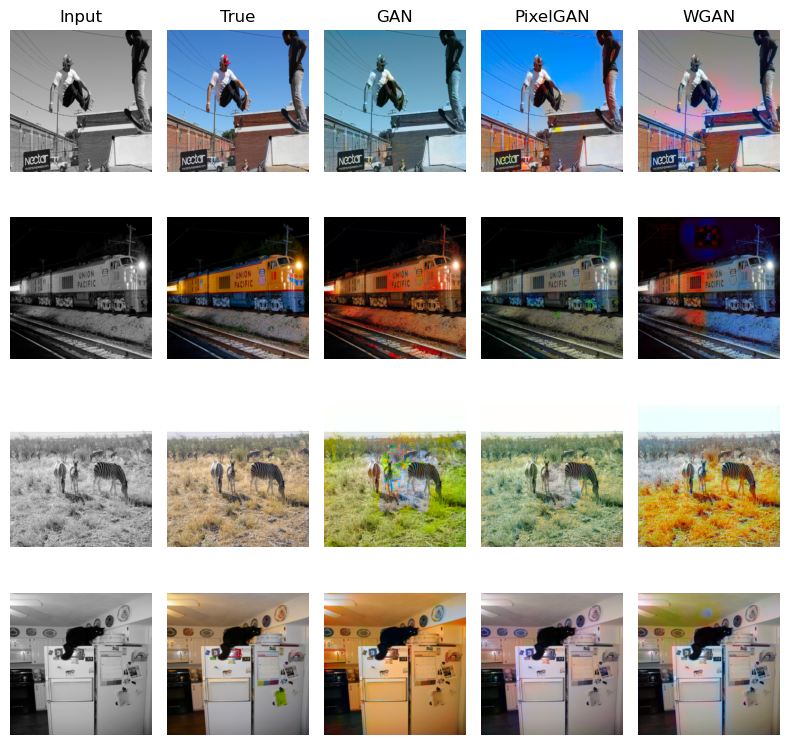

C:\Users\loren\anaconda3\envs\NNDL-torch\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 91 pixels
  return func(*args, **kwargs)


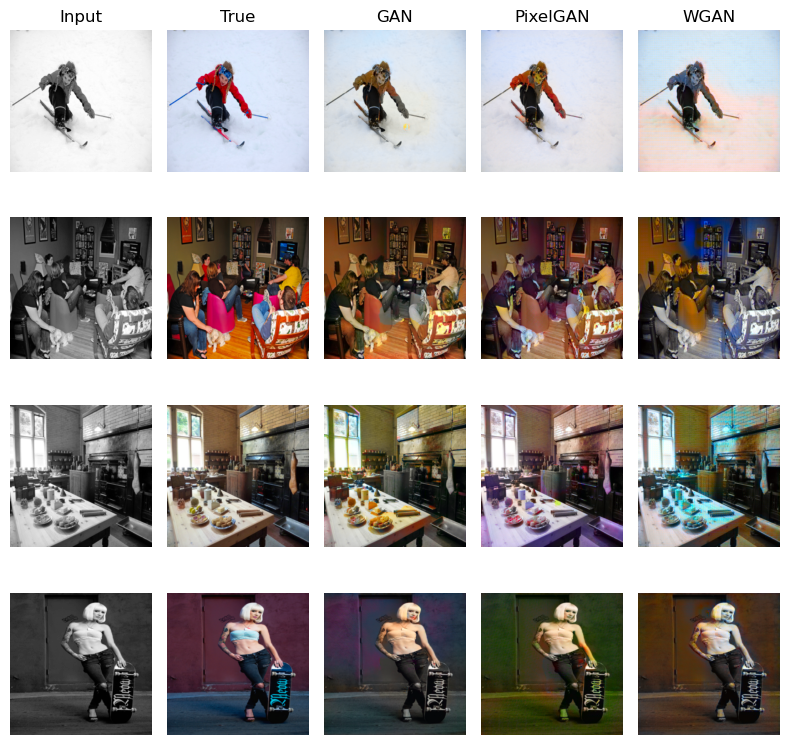

C:\Users\loren\anaconda3\envs\NNDL-torch\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 4 pixels
  return func(*args, **kwargs)
C:\Users\loren\anaconda3\envs\NNDL-torch\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 246 pixels
  return func(*args, **kwargs)


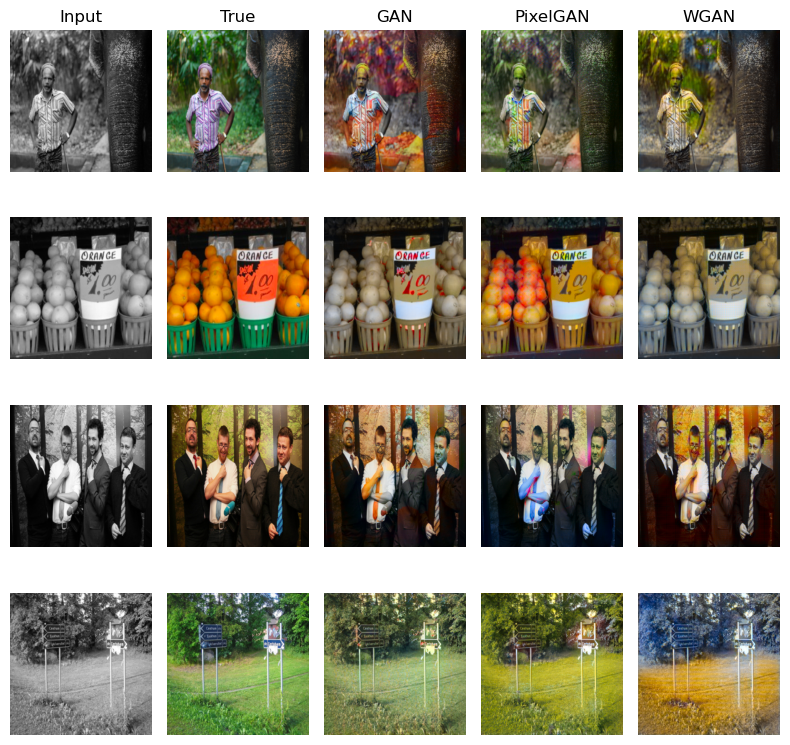

C:\Users\loren\anaconda3\envs\NNDL-torch\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 342 pixels
  return func(*args, **kwargs)


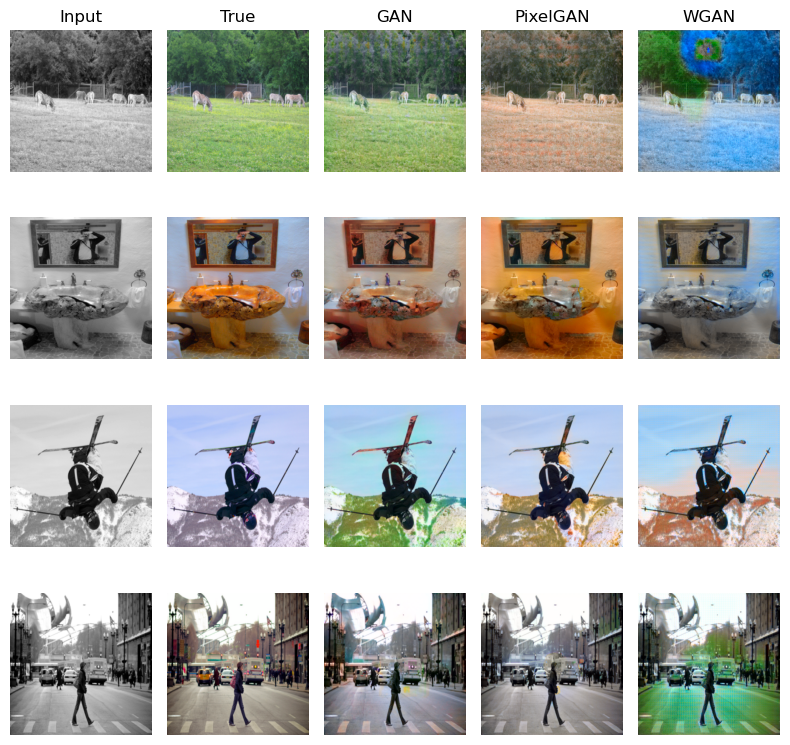

C:\Users\loren\anaconda3\envs\NNDL-torch\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 217 pixels
  return func(*args, **kwargs)


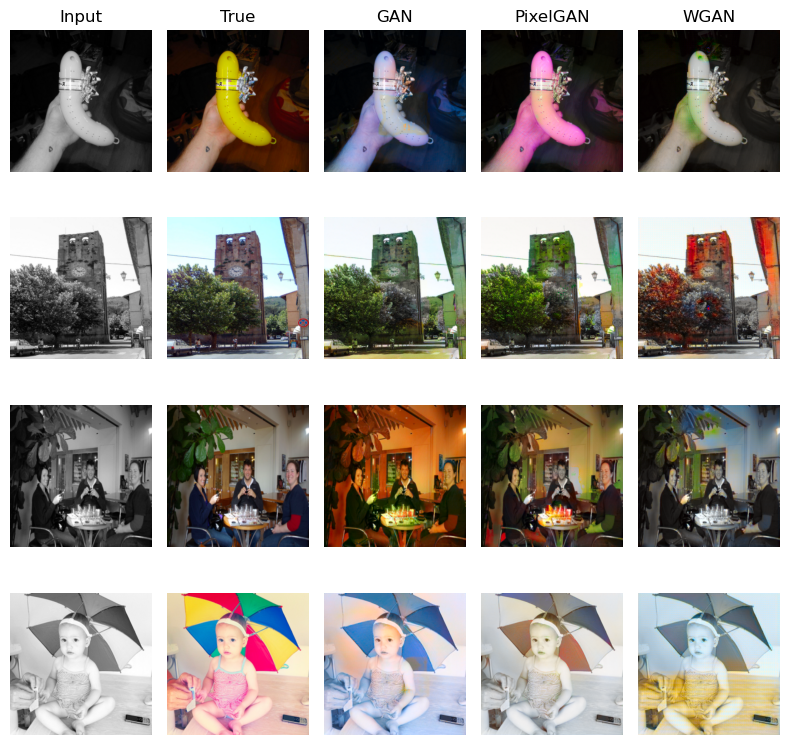

C:\Users\loren\anaconda3\envs\NNDL-torch\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 449 pixels
  return func(*args, **kwargs)


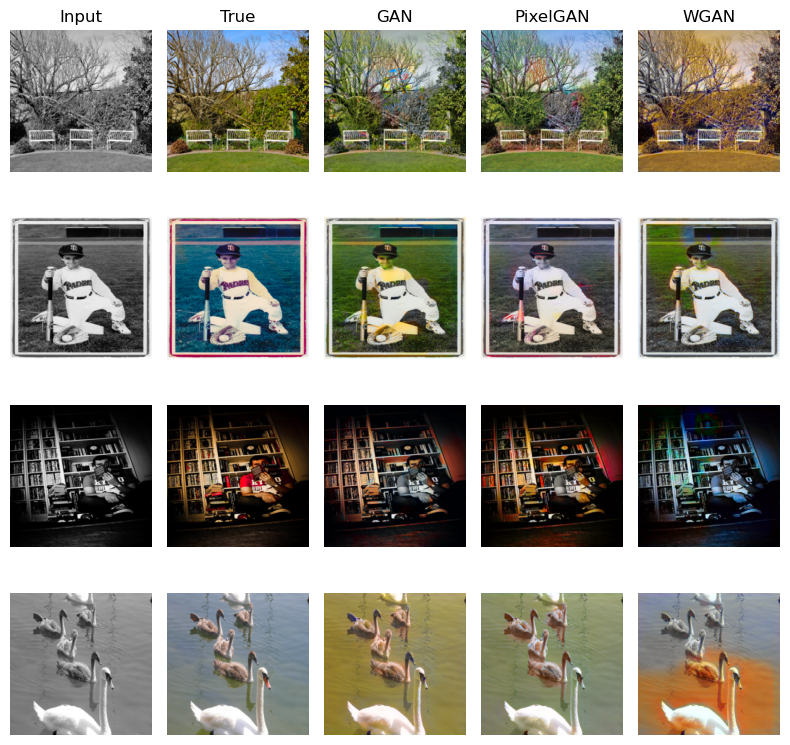

C:\Users\loren\anaconda3\envs\NNDL-torch\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 550 pixels
  return func(*args, **kwargs)


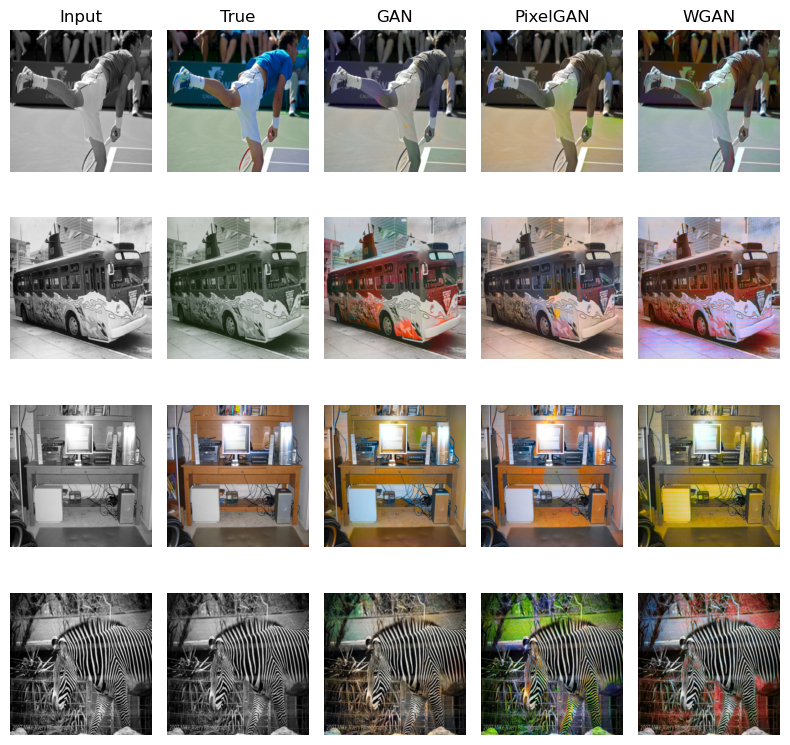

C:\Users\loren\anaconda3\envs\NNDL-torch\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 76 pixels
  return func(*args, **kwargs)


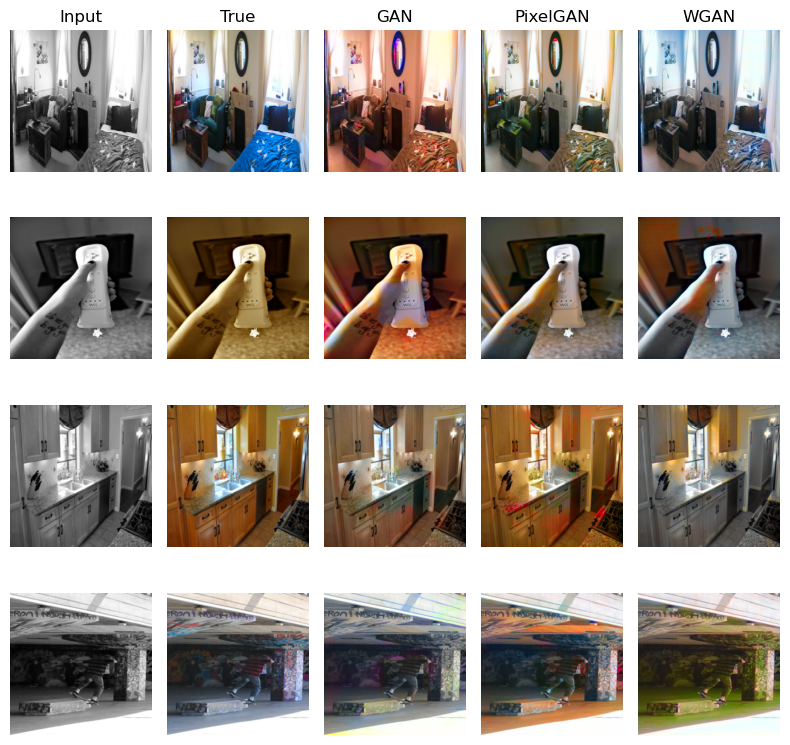

C:\Users\loren\anaconda3\envs\NNDL-torch\lib\site-packages\skimage\_shared\utils.py:394: UserWarning: Color data out of range: Z < 0 in 247 pixels
  return func(*args, **kwargs)


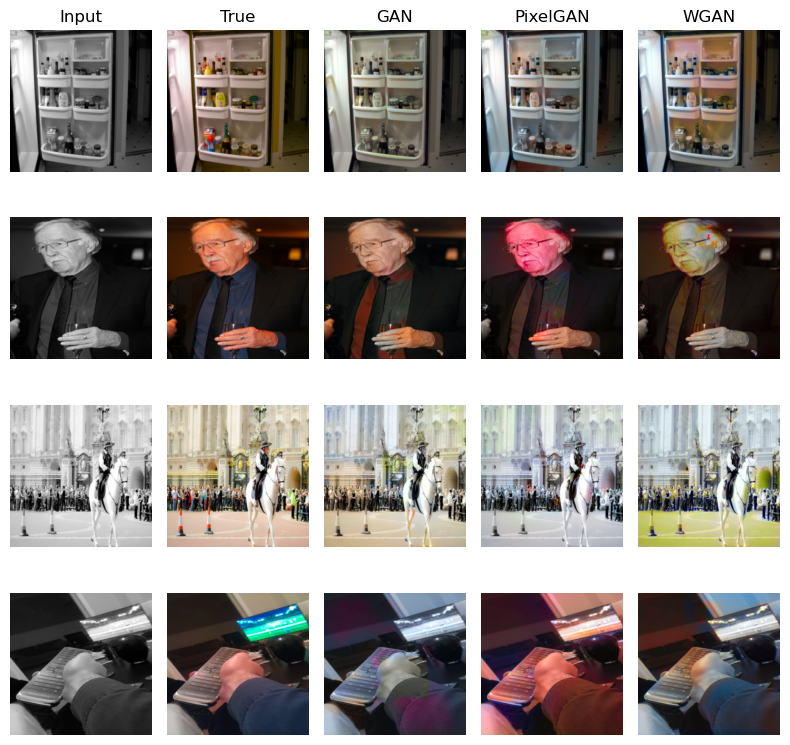

In [13]:
for index, (L, ab) in enumerate(test_dataloader):

    if index < 60:
        continue
    with torch.no_grad():
        L = L.to(device)
        ab = ab.to(device)
        ab_generated_gan = generator_gan(L)
        ab_generated_pgan = generator_pgan(L)
        ab_generated_wgan = generator_wgan(L)

    L = L.permute(0, 2, 3, 1)
    ab = ab.permute(0, 2, 3, 1)
    ab_generated_gan = ab_generated_gan.permute(0, 2, 3, 1)
    ab_generated_pgan = ab_generated_pgan.permute(0, 2, 3, 1)
    ab_generated_wgan = ab_generated_wgan.permute(0, 2, 3, 1)

    L = (L+1) * 50
    ab = ab * 128
    ab_generated_gan = ab_generated_gan * 128
    ab_generated_pgan = ab_generated_pgan * 128
    ab_generated_wgan = ab_generated_wgan * 128

    input_imgs = L.cpu().detach().numpy()
    true_imgs = torch.cat((L, ab), dim=3).cpu().detach().numpy()
    fake_imgs_gan = torch.cat((L, ab_generated_gan), dim=3).cpu().detach().numpy()
    fake_imgs_pgan = torch.cat((L, ab_generated_pgan), dim=3).cpu().detach().numpy()
    fake_imgs_wgan = torch.cat((L, ab_generated_wgan), dim=3).cpu().detach().numpy()
    true_imgs = lab2rgb(true_imgs)
    fake_imgs_gan = lab2rgb(fake_imgs_gan)
    fake_imgs_pgan = lab2rgb(fake_imgs_pgan)
    fake_imgs_wgan = lab2rgb(fake_imgs_wgan)

    # plot images in 8 rows and 3 columns (input, true, generated)
    fig, axs = plt.subplots(4, 5, figsize=(8, 8))
    for i in range(4):
        axs[i, 0].imshow(input_imgs[i], cmap='gray')
        axs[i, 1].imshow(true_imgs[i])
        axs[i, 2].imshow(fake_imgs_gan[i])
        axs[i, 3].imshow(fake_imgs_pgan[i])
        axs[i, 4].imshow(fake_imgs_wgan[i])
        axs[i, 0].axis('off')
        axs[i, 1].axis('off')
        axs[i, 2].axis('off')
        axs[i, 3].axis('off')
        axs[i, 4].axis('off')
        # set titles only for first row
        if i == 0:
            axs[i, 0].set_title('Input')
            axs[i, 1].set_title('True')
            axs[i, 2].set_title('GAN')
            axs[i, 3].set_title('PixelGAN')
            axs[i, 4].set_title('WGAN')

    plt.tight_layout()
    plt.show()

    if index == 100:
        break



# Generate multiple outputs from same input

In [31]:
L, ab = test_dataset.__getitem__(22)

# add batch dimension and stack L and ab
L = L.unsqueeze(0)
L = torch.cat([L]*BATCH_SIZE, dim=0)
ab = ab.unsqueeze(0)


In [32]:
generated_same_img = [generator_pgan(L.to(device)) for _ in range(5)]

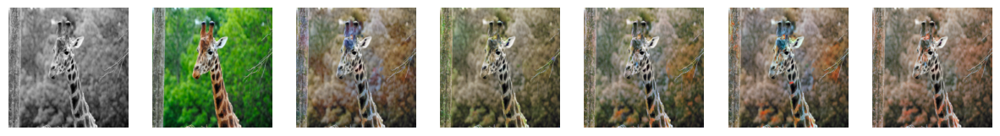

In [33]:
# plot input, real and multiple generated images
fig, axs = plt.subplots(1, 7, figsize=(15, 5))

L = L[0].unsqueeze(0)
L = L.permute(0, 2, 3, 1)
ab = ab.permute(0, 2, 3, 1)

L = (L+1) * 50
ab = ab * 128

input_imgs = L.cpu().detach().numpy()
true_imgs = torch.cat((L, ab), dim=3).cpu().detach().numpy()
true_imgs = lab2rgb(true_imgs)

axs[0].imshow(input_imgs[0], cmap='gray')
axs[1].imshow(true_imgs[0])

for i, ab_generated in enumerate(generated_same_img):

    ab_generated = ab_generated[0].unsqueeze(0)
    ab_generated = ab_generated.permute(0, 2, 3, 1)
    ab_generated = ab_generated * 128

    fake_imgs = torch.cat((L, ab_generated.cpu()), dim=3).cpu().detach().numpy()
    fake_imgs = lab2rgb(fake_imgs)

    axs[i+2].imshow(fake_imgs[0])

# disable axis
for i in range(7):
    axs[i].axis('off')

# Compute metrics on test set

In [16]:
def compute_metrics(inputs, targets, outputs):
    """
    Updates the metrics for the current batch.
    :param inputs: input images
    :param targets: target images
    :param outputs: generated images
    :return: uiqi value (needs to be treated separately for memory issues)
    """

    # map values in [0, 1] and combine channels, inputs, targets and outputs are in range [-1, 1]
    L = inputs
    L = (L + 1) * 0.5
    ab_true = targets * 0.5 + 0.5
    ab_pred = outputs * 0.5 + 0.5
    true_imgs = torch.cat((L, ab_true), dim=1)
    fake_imgs = torch.cat((L, ab_pred), dim=1)

    # compute the metrics
    uiqi = 0
    for metric in metrics:
        if metric._get_name() == 'FrechetInceptionDistance':
            metric.update(true_imgs, real=True)
            metric.update(fake_imgs, real=False)
        elif metric._get_name() == 'UniversalImageQualityIndex':
            # need to use functional interface
            uiqi = torchmetrics.functional.universal_image_quality_index(fake_imgs, true_imgs,
                                                                         data_range=1.0,
                                                                         reduction=None)
            uiqi = uiqi.mean(axis=(1, 2, 3))
            uiqi = uiqi[~torch.isnan(uiqi)].mean()
        else:
            metric.update(fake_imgs, true_imgs)

    return uiqi

In [19]:
uiqi = []
for index, (L, ab) in enumerate(test_dataloader):
    L = L.to(device)
    ab = ab.to(device)
    ab_generated = generator_wgan(L)

    true_img = torch.cat((L, ab), dim=1)
    fake_img = torch.cat((L, ab_generated), dim=1)

    uiqi_ = compute_metrics(L, ab, ab_generated)
    uiqi.append(uiqi_.detach().cpu().item())

uiqi = np.array(uiqi)
uiqi = uiqi[np.isfinite(uiqi)].mean()

for metric in metrics:
    if metric._get_name() == 'UniversalImageQualityIndex':
        print(f'uiqi: {uiqi}')
        continue
    name = metric._get_name().lower()
    print(f'{name}: {metric.compute()}')



frechetinceptiondistance: 3.2165780067443848
structuralsimilarityindexmeasure: 0.8419205546379089
peaksignalnoiseratio: 23.83074188232422
learnedperceptualimagepatchsimilarity: 0.1618676781654358
uiqi: 0.34976345938540465
